# Generates a visual representation of a Belousov - Zhabotinsky Reaction

 reaction equations
src : http://discovery.ucl.ac.uk/17241/1/17241.pdf

Simulated equations:

$a_{t+1} = a_t + a_t(b_t - c_t)$

$b_{t+1} = b_t + b_t(c_t - a_t)$

$c_{t+1} = c_t + c_t(a_t - b_t)$


In [0]:
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation

%matplotlib inline
from IPython.display import HTML

In [0]:
WIDTH, HEIGHT = 600, 400

In [0]:
class BZSim():
    def __init__(self, width, height):
        self.w = width
        self.h = height

        # initialize grid representation
        ## since we need the previous instance, we store two matrices
        ## and switch between then at each timestep
        self.a = np.zeros((2, self.h, self.w))
        self.b = np.zeros((2, self.h, self.w))
        self.c = np.zeros((2, self.h, self.w))

        # bit index representing which matrix is curr timestep
        self.p = 0
        
    def setup(self):
        ''' initializes a, b, c matrices where elements ~ unif(0,1) '''
        for i in range(self.h):
            for j in range(self.w):
                self.a[self.p][i][j] = random.random()
                self.b[self.p][i][j] = random.random()
                self.c[self.p][i][j] = random.random()

    @staticmethod
    def clamp(n, small, big):
        '''  helper, enforces that small <= n <= big '''
        return max(min(big, n), small)
    
    def step(self):
        ''' one step in the simulation '''
        
        # inverse of the timestep bit
        q = 1 - self.p
        
        for i in range(self.h):
            for j in range(self.w):
                c_a, c_b, c_c = self.get_adjacents(i, j)

                # reaction equations
                self.a[q][i][j] = self.clamp(c_a + c_a * (c_b - c_c), 0, 1)
                self.b[q][i][j] = self.clamp(c_b + c_b * (c_c - c_a), 0, 1)
                self.c[q][i][j] = self.clamp(c_c + c_c * (c_a - c_b), 0, 1)

        # inverts the bit since curr timestep is now prev timestep
        self.p = 1 - self.p

    def get_adjacents(self, i, j):
        ''' returns the average value of the surrounding entries '''
        c_a = c_b = c_c = 0.0

        for k in range(3):
            for l in range(3):

                # cheating alittle in edge case by just wrapping around matrix
                x = (i + k) % self.h
                y = (j + l) % self.w
                
                c_a += self.a[self.p][x][y]
                c_b += self.b[self.p][x][y]
                c_c += self.c[self.p][x][y]

        # average across the nine values
        return c_a / 9, c_b / 9, c_c / 9

    def animate(self, n_frames = 10, cmap = 'jet', save = False):
        ''' animates grid using plt for n_frames using cmap as colormap'''
        
        fig = plt.figure()
        im = plt.imshow(self.a[self.p])

        ims = []
        ims.append([im])
        
        # add the next frames
        for _ in range(n_frames):
            self.step()
            im = plt.imshow(self.a[1 - self.p], cmap = cmap, animated = True)
            ims.append([im])

        anim = animation.ArtistAnimation(fig, ims, interval=100, blit=True, repeat_delay=2000)
        
        plt.close()

        if save:
          anim.save(filename='bz.mp4', fps=15)
          
        return HTML(anim.to_html5_video())

    def display(self):
        plt.imshow(self.a[1 - self.p])
        plt.close()

In [0]:
sim = BZSim(WIDTH, HEIGHT)

sim.setup()

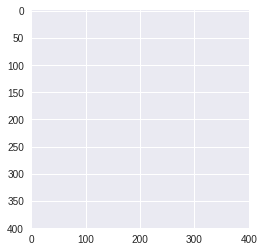

In [0]:
sim.animate(save = True)

In [0]:
sim.animate(n_frames = 100, save = True)

# ODEs

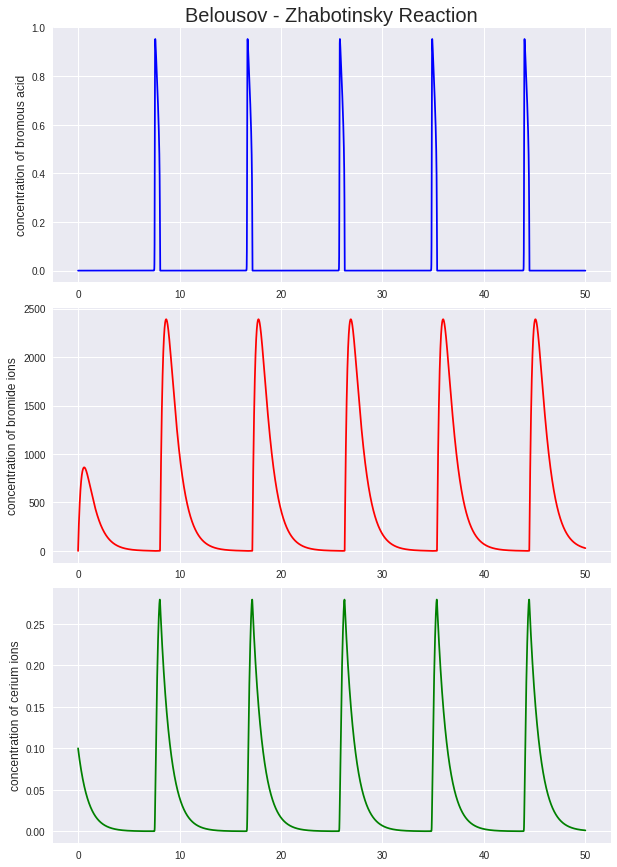

In [0]:
import numpy as np
from scipy.integrate import odeint
import matplotlib.pyplot as plt

# BZ constants
q, f, eps, delta = 3.1746e-5, 1, 0.0099, 2.4802e-5

# initial values
x0, y0, z0 = 0, 0, 0.1

# end time
t_e = 50 

# number of timesteps
n_iter = 10000

# t values
t = np.linspace(0, t_e, n_iter)

# reaction ODE
def bz_reaction(triple, t, q, f, eps, delta):
    x, y, z = triple # (x, y, z) tuple
    dx = (q*y - x*y + x*(1-x)) / eps
    dy = (-q*y - x*y + f*z) / delta
    dz = x-z
    return (dx, dy, dz)

f = odeint(bz_reaction, (x0, y0, z0), t, args=((q, f, eps, delta)))

# get results
x, y, z = f.T

# plot results
fig = plt.figure(figsize=(10, 15), facecolor='white')
fig.subplots_adjust(wspace=0.1, hspace=0.1)

ax1 = fig.add_subplot(3, 1, 1)
ax1.set_ylabel('concentration of bromous acid', fontsize=12)

ax2 = fig.add_subplot(3, 1, 2)
ax2.set_ylabel('concentration of bromide ions', fontsize=12)

ax3 = fig.add_subplot(3, 1, 3)
ax3.set_ylabel('concentration of cerium ions', fontsize=12)

ax1.set_title('Belousov - Zhabotinsky Reaction', fontsize = 20)

ax1.plot(t, x, 'b-')
ax2.plot(t, y, 'r-')
ax3.plot(t, z, 'g-')

plt.show()

# Updated Simulation

Simulated equations: 

$a_{t+1} = a_t + a_t(\alpha b_t - \gamma c_t)$

$b_{t+1} = b_t + b_t(\beta c_t - \alpha a_t)$

$c_{t+1} = c_t + c_t(\gamma a_t -\beta  b_t)$

In [0]:
import numpy as np
from scipy.signal import convolve2d
import matplotlib.pyplot as plt
from matplotlib import animation
%matplotlib inline
from IPython.display import HTML

WIDTH, HEIGHT = 600, 400

class BZSimConv():
  ''' Improved BZ model that adds parameter constants, 
      uses numpy for improved efficiency, 
      and uses scipy convolutions to find average
  '''
  def __init__(self, width, height, alpha = 1.2, beta = 1, gamma = 1, plot = True):
    # width, height of the image
    self.w, self.h = width, height
    
    # reaction constants
    self.alpha, self.beta, self.gamma = alpha, beta, gamma

    # initialize grid with random amounts of a, b and c
    self.data = np.random.random(size=(2, 3, self.h, self.w))
    
    self.plot = plot
    
    if self.plot:
        self.pt = []
    
    # bit mask
    self.p = 0
    
  def reset(self, alpha = 1.2, beta = 1, gamma = 1, plot = True):
    
    # re-initialize grid with random amounts of a, b and c
    self.data = np.random.random(size=(2, 3, self.h, self.w))
    
    # updatereaction constants
    self.alpha, self.beta, self.gamma = alpha, beta, gamma
    
    self.plot = plot
    
    if self.plot:
        self.pt = []
    
  def step(self, p = -1):
    """ updates data[p] using data[q] for a time step """
    
    # we pass in a separate p for easier animating
    p = p if p > -1 else self.p
    
    # get next grid
    q = 1 - p
    
    s = np.zeros((3, self.h, self.w))
    
    m = np.ones((3, 3)) / 9
    
    # count the average amount of each species in the 9 cells around each cell
    for k in range(3):
        # uses convolution with 3x3 matrix m for faster computation
        s[k] = convolve2d(self.data[p,k], m, mode = 'same', boundary = 'wrap')
        
    # reaction equations
    self.data[q, 0] = s[0] + s[0]*(self.alpha * s[1] - self.gamma * s[2])
    self.data[q, 1] = s[1] + s[1]*(self.beta * s[2] - self.alpha * s[0])
    self.data[q, 2] = s[2] + s[2]*(self.gamma * s[0] - self.beta * s[1])
    
    # keeps species concentrations within [0, 1]
    np.clip(self.data[q], 0, 1, self.data[q])

    self.pt.append(self.data[q, 0, 30, 30])

  def simulate(self, save = False, colormap = plt.cm.winter):

    # Set up the image
    fig, ax = plt.subplots()
    im = ax.imshow(self.data[0,0], cmap = colormap)
    ax.axis('off')

    def animate(i):
      """Update the image for iteration i of the Matplotlib animation."""

      arr = self.step(i % 2)
      im.set_array(self.data[i % 2, 0])
      return [im]

    
    anim = animation.FuncAnimation(fig, animate, frames = 200, interval = 100,
                               blit=False)

    if save:
      anim.save(filename='bz.mp4', fps=15)
    
    if self.plot:
        self.plot_point()
        
    return HTML(anim.to_html5_video())

  def plot_point(self):
    plt.figure(figsize=(10, 5), facecolor='white')
    plt.title("Point Oscillation (%f, %f, %f)" % (self.alpha, self.beta, self.gamma))
    plt.plot(self.pt)
    plt.ylabel("Concentration")
    plt.xlabel("time step")
    

In [0]:
conv = BZSimConv(WIDTH, HEIGHT)

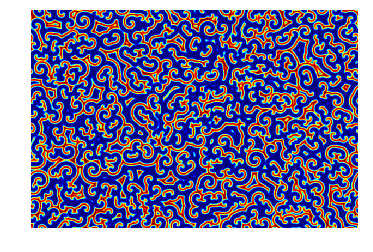

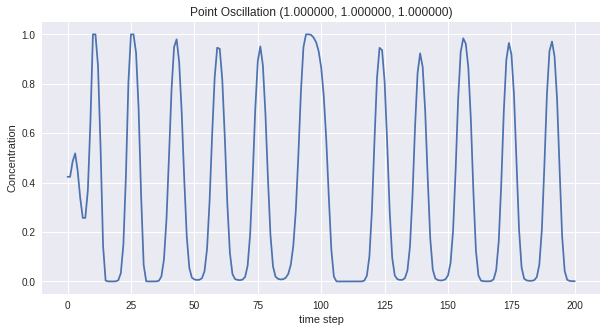

In [0]:
conv.reset(1, 1, 1)
conv.simulate(save = True, colormap = 'jet')

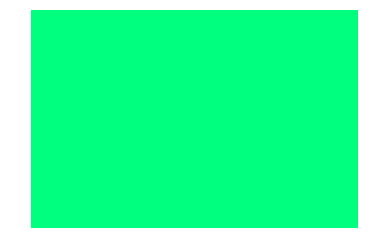

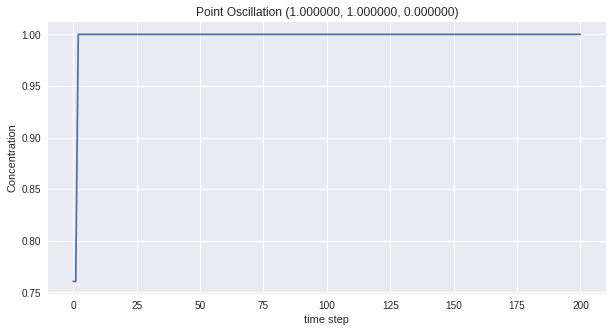

In [0]:
conv.reset(1, 1, 0)
conv.simulate(save = True)

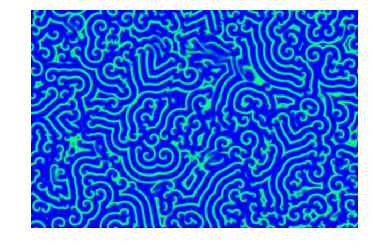

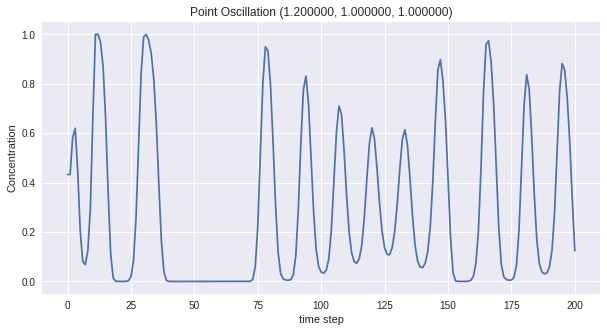

In [0]:
conv.reset(1.2, 1, 1)
conv.simulate(save = True)

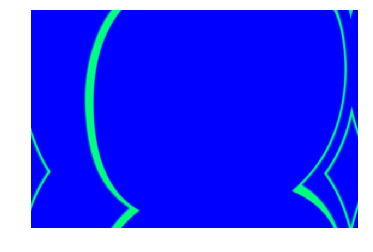

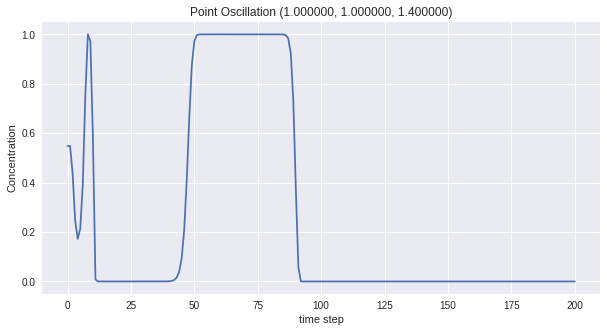

In [0]:
conv.reset(1, 1, 1.4)
conv.simulate(save = True)

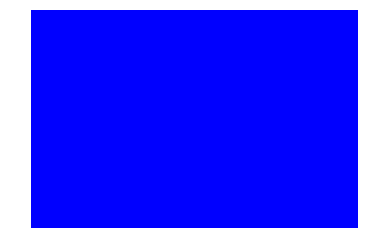

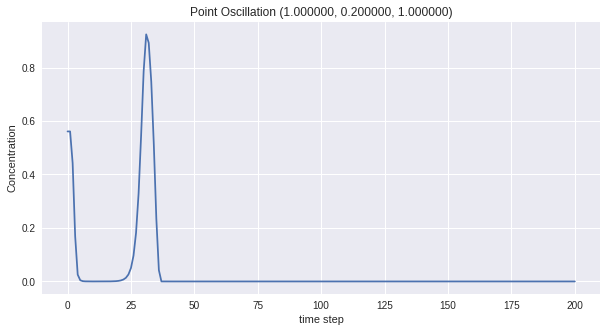

In [0]:
conv.reset(1, 0.2, 1)
conv.simulate(save = True)

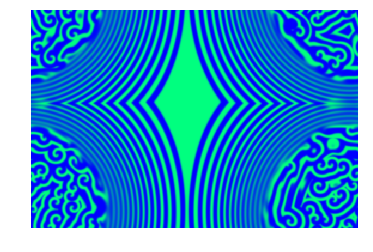

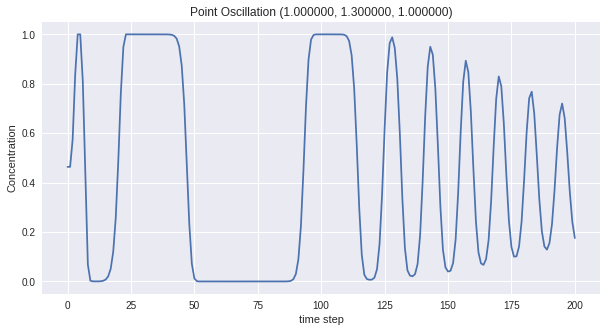

In [0]:
conv.reset(1, 1.3, 1)
conv.simulate(save = True)

Text(0, 0.5, 'asdf')

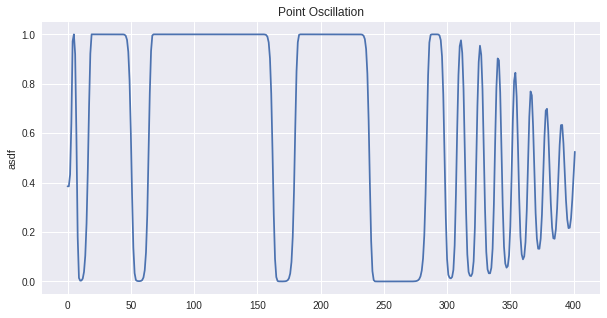

# Color Adjustment

In [0]:
import numpy as np
from scipy.signal import convolve2d
import matplotlib.pyplot as plt
from matplotlib import animation
from skimage import io
%matplotlib inline
from IPython.display import HTML

WIDTH, HEIGHT = 600, 400

class BZSimConv():
  ''' Improved BZ model that adds parameter constants, 
      uses numpy for improved efficiency, 
      and uses scipy convolutions to find average
  '''
  def __init__(self, width, height, alpha = 1.2, beta = 1, gamma = 1):
    # width, height of the image
    self.w, self.h = width, height
    
    # reaction constants
    self.alpha, self.beta, self.gamma = alpha, beta, gamma

    # initialize grid with random amounts of a, b and c
    self.data = np.random.random(size=(2, 3, self.h, self.w))
    
    # bit mask
    self.p = 0
    
  def reset(self, alpha = 1.2, beta = 1, gamma = 1):
    
    # re-initialize grid with random amounts of a, b and c
    self.data = np.random.random(size=(2, 3, self.h, self.w))
    
    # updatereaction constants
    self.alpha, self.beta, self.gamma = alpha, beta, gamma
    
  def step(self, p = -1):
    """ updates data[p] using data[q] for a time step """
    
    # we pass in a separate p for easier animating
    p = p if p > -1 else self.p
    
    # get next grid
    q = 1 - p
    
    s = np.zeros((3, self.h, self.w))
    
    m = np.ones((3, 3)) / 9
    
    # count the average amount of each species in the 9 cells around each cell
    for k in range(3):
        # uses convolution with 3x3 matrix m for faster computation
        s[k] = convolve2d(self.data[p,k], m, mode = 'same', boundary = 'wrap')
        
    # reaction equations
    self.data[q, 0] = s[0] + s[0]*(self.alpha * s[1] - self.gamma * s[2])
    self.data[q, 1] = s[1] + s[1]*(self.beta * s[2] - self.alpha * s[0])
    self.data[q, 2] = s[2] + s[2]*(self.gamma * s[0] - self.beta * s[1])
    
    # keeps species concentrations within [0, 1]
    np.clip(self.data[q], 0, 1, self.data[q])


  def simulate(self, save = False, c = 2, I = 1, g = 0.2, b = 0.8):
    ''' passed in additional color parameters '''
    
    # Set up the image
    fig, ax = plt.subplots()
    im = ax.imshow(self.data[0,0])
    ax.axis('off')

    def animate(i):
      """Update the image for iteration i of the Matplotlib animation."""

      self.step(i % 2)

      # redness is I * exp(c*t) which is then normalized
      colorer = lambda t:  (I * np.exp(c * t - c), g, b)
      vfunc = np.vectorize(colorer)
      arr = vfunc(self.data[i % 2, 0])
      im.set_array(np.swapaxes(arr, 0, 2))
      return [im]

    
    anim = animation.FuncAnimation(fig, animate, frames = 200, interval = 100, blit=False)

    if save:
      anim.save(filename='bz.mp4', fps=15)
    
    return HTML(anim.to_html5_video())

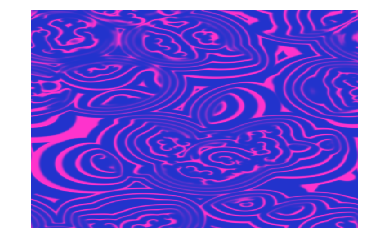

In [0]:
conv = BZSimConv(600, 400)
conv.simulate()